In [1]:
from google.colab import drive
drive.mount("/content/gdrive")

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


In [2]:
cd gdrive/My\ Drive

/content/gdrive/My Drive


In [0]:
!ls

 16022020_175830_361_IDBI_STATEMENT.pdf
 1DS16CS029.docx
 1DS16CS029_INS_CAANVITHA_8A.pdf
 CAANVITHA_1DS16CS029_QT_CIE2.pdf
'Candidate Information Sheet.pdf'
 Classroom
'Colab Notebooks'
'Copy of Demo.ipynb'
'Copy of FYP_Surveypaper.doc'
'Copy of iCAN.ipynb'
'CTE Academy for GHCI.pdf'
 darknet
'Final Demo'
 FinalYearProject2019-2020
'GHCI 2019_Talking Points_V3.pdf'
 HOI
 iCANFinalProjectReport.docx
 IMG_20200209_200721.jpg
'MachinelearningQuiz(udemy).gdoc'
'MarksCards(B.Tech)'
 NTAT.pdf
 Perfios
 ProblemStatement.gdoc
'Screenshot_20191012-012525_Samsung Internet.jpg'
"Senior's FYP"
'State Bank of India.pdf'
 TCS
'Untitled document.gdoc'
'Untitled presentation.gslides'


In [3]:
cd Final\ Demo/iCAN/

/content/gdrive/My Drive/Final Demo/iCAN


In [15]:
cd tools

/content/gdrive/My Drive/Final Demo/iCAN/tools


In [0]:
from __future__ import absolute_import
from __future__ import division
from __future__ import print_function

%matplotlib inline
from PIL import Image
import _init_paths
import matplotlib.pyplot as plt
from ult.config import cfg
import pickle
import json
import numpy as np
import cv2
import os
import sys

CLASSES = ('__background__', 'person', 'bicycle', 'car', 'motorcycle', 'airplane', 'bus','train', 'truck', 'boat', 'traffic light', 'fire hydrant', 'stop sign', 'parking meter','bench', 'bird', 'cat', 'dog', 'horse', 'sheep', 'cow', 'elephant', 'bear', 'zebra', 'giraffe', 'backpack','umbrella', 'handbag', 'tie', 'suitcase', 'frisbee', 'skis', 'snowboard', 'sports ball', 'kite','baseball bat', 'baseball glove', 'skateboard', 'surfboard', 'tennis racket', 'bottle', 'wine glass', 'cup', 'fork', 'knife', 'spoon', 'bowl','banana', 'apple', 'sandwich', 'orange', 'broccoli','carrot', 'hot dog', 'pizza', 'donut', 'cake', 'chair', 'couch', 'potted plant', 'bed', 'dining table','toilet', 'tv', 'laptop', 'mouse', 'remote', 'keyboard', 'cell phone', 'microwave', 'oven','toaster', 'sink', 'refrigerator', 'book', 'clock', 'vase', 'scissors', 'teddy bear', 'hair drier','toothbrush', 'table')

In [0]:
Detection = pickle.load( open( cfg.ROOT_DIR + "/demo/HOI_Detection.pkl", "rb" ) )

In [18]:
Detection

[{u'carry_obj': array([nan, nan, nan, nan,  0.]),
  u'carry_obj_agent': 2.2166717e-10,
  u'catch_obj': array([nan, nan, nan, nan,  0.]),
  u'catch_obj_agent': 9.2636204e-10,
  u'cut_instr': array([nan, nan, nan, nan,  0.]),
  u'cut_instr_agent': 3.1764307e-09,
  u'cut_obj': array([nan, nan, nan, nan,  0.]),
  u'cut_obj_agent': 3.3088356e-09,
  u'drink_instr': array([nan, nan, nan, nan,  0.]),
  u'drink_instr_agent': 2.9165344e-06,
  u'eat_instr': array([nan, nan, nan, nan,  0.]),
  u'eat_instr_agent': 5.267312e-09,
  u'eat_obj': array([nan, nan, nan, nan,  0.]),
  u'eat_obj_agent': 4.018281e-09,
  u'hit_instr': array([nan, nan, nan, nan,  0.]),
  u'hit_instr_agent': 1.2588989e-06,
  u'hit_obj': array([nan, nan, nan, nan,  0.]),
  u'hit_obj_agent': 1.2597025e-06,
  u'hold_obj': array([1.06872156e+03, 6.99227661e+02, 1.34972644e+03, 8.78993652e+02,
         6.40000000e+01, 3.83140108e-02]),
  u'hold_obj_agent': 0.97342664,
  'image_id': '0.png',
  u'jump_instr': array([nan, nan, nan, nan

0.png
1.png
2.png
3.png
4.png
5.png
6.png
7.png
8.png
9.png
10.png
11.png
12.png
13.png
Object_Detection.pkl


IOError: ignored

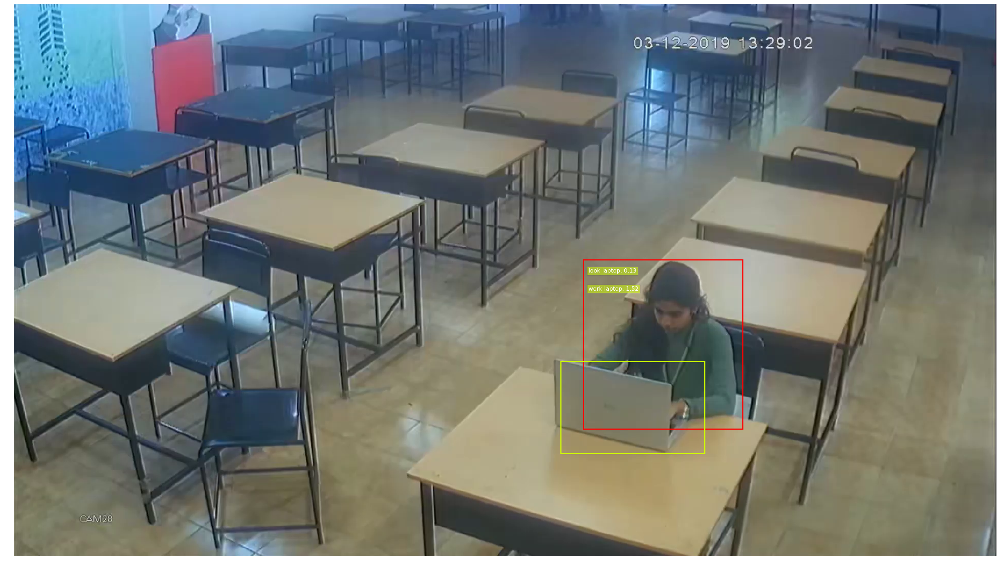

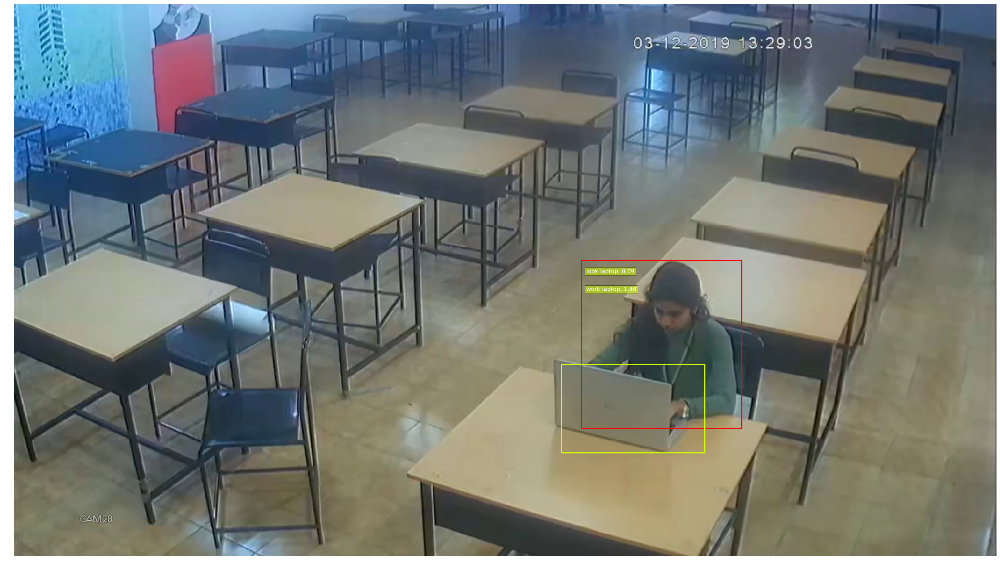

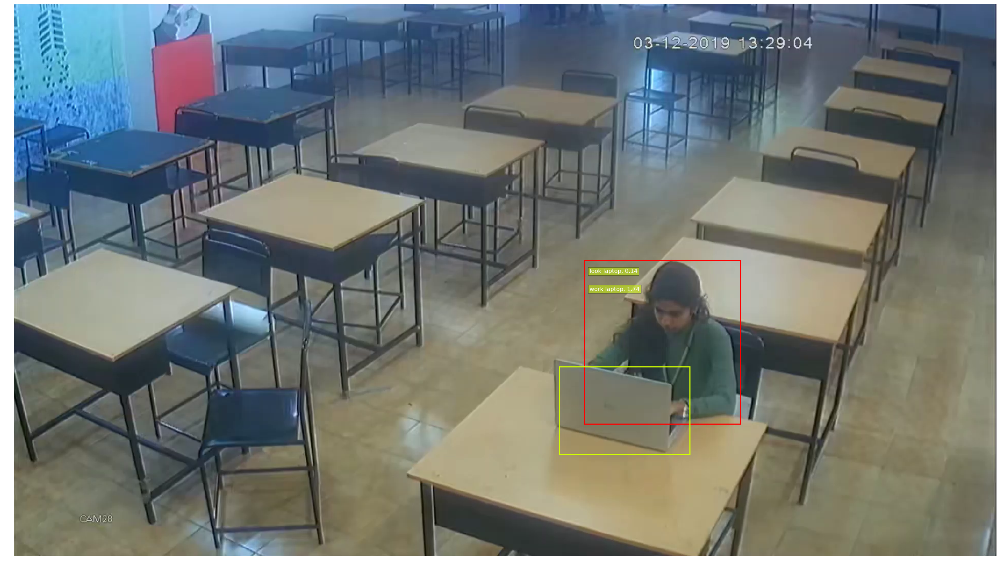

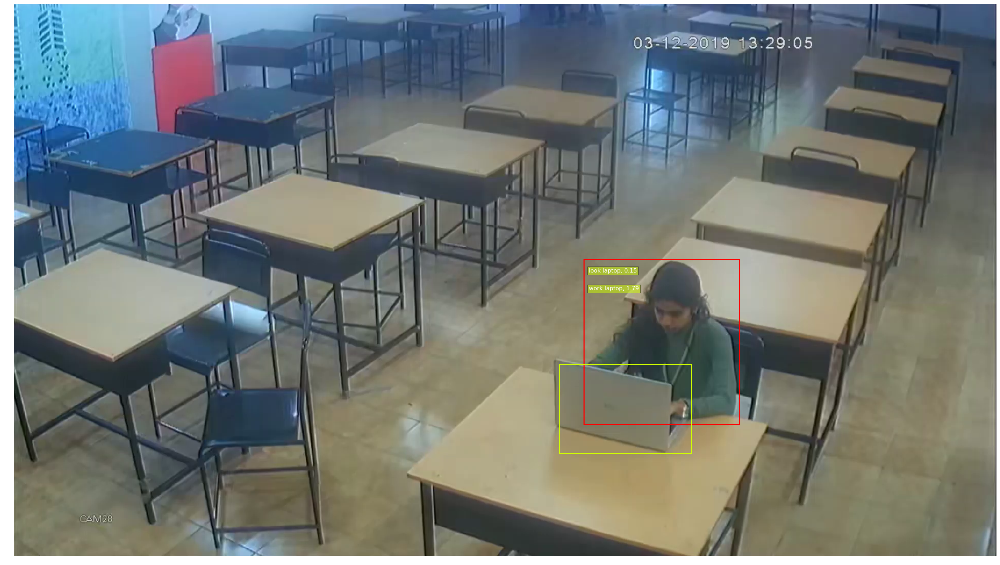

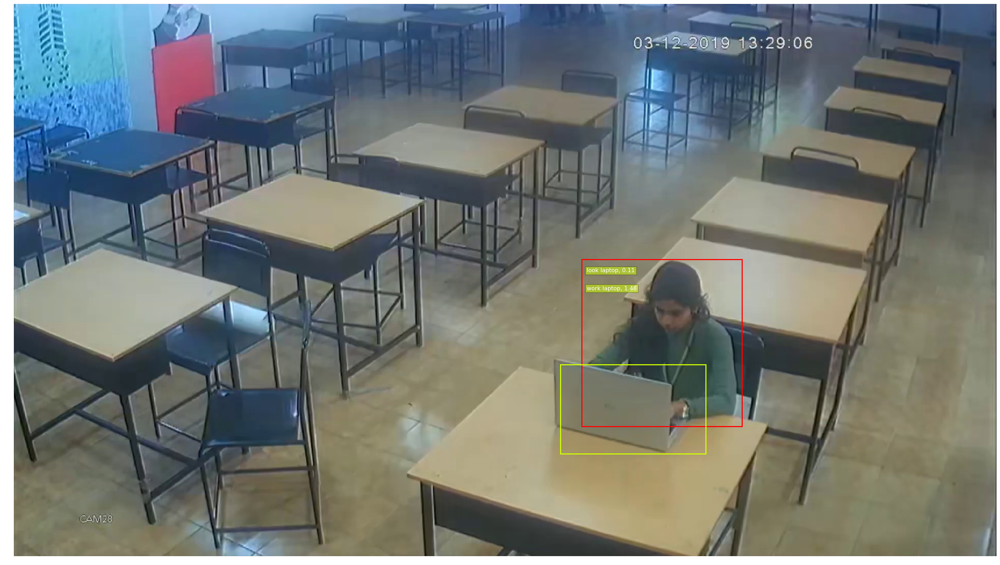

...

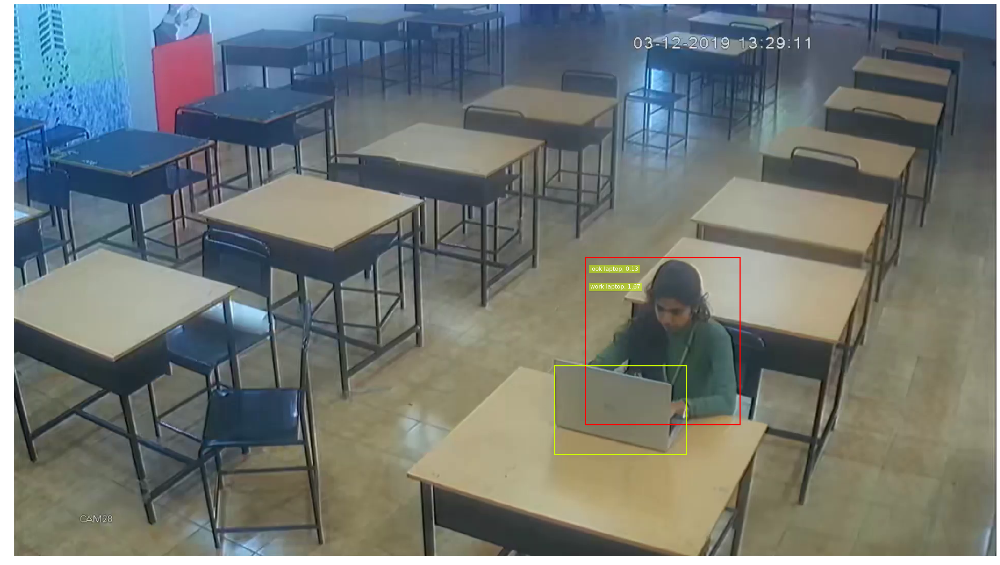

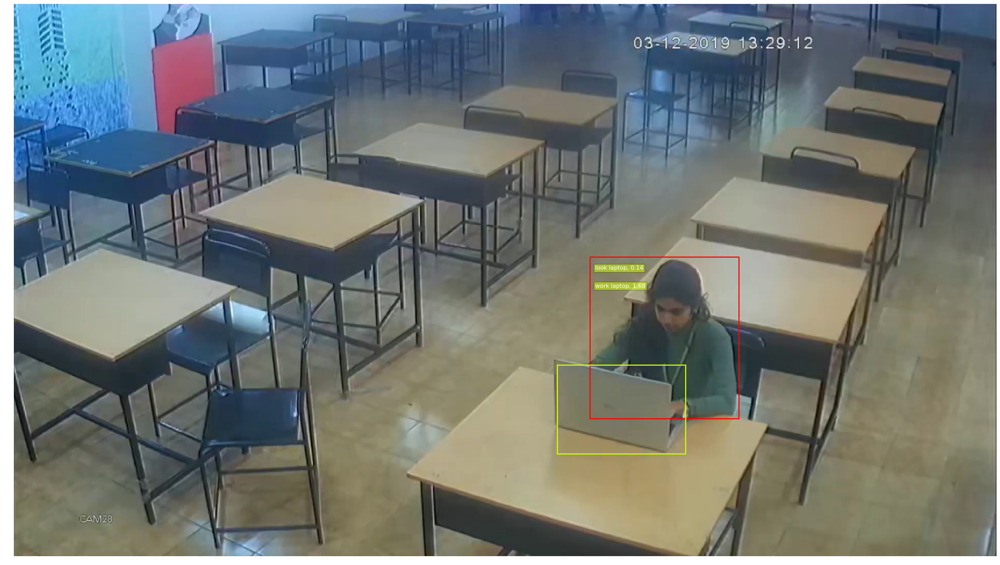

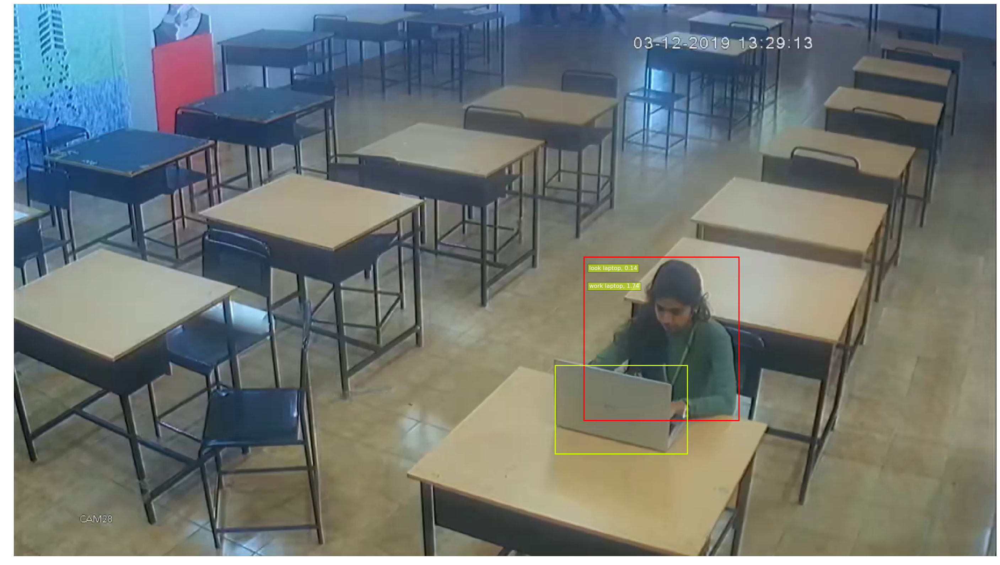

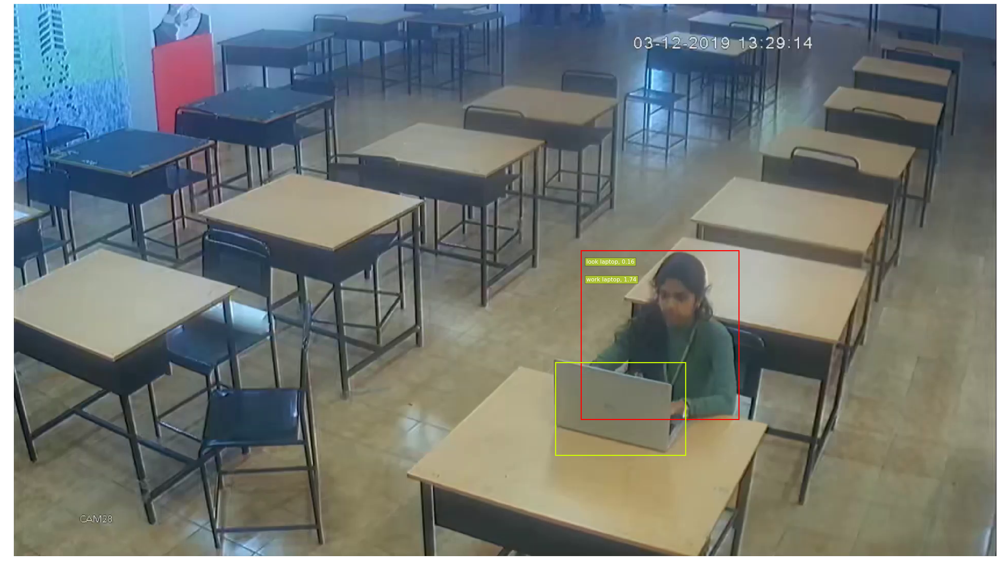

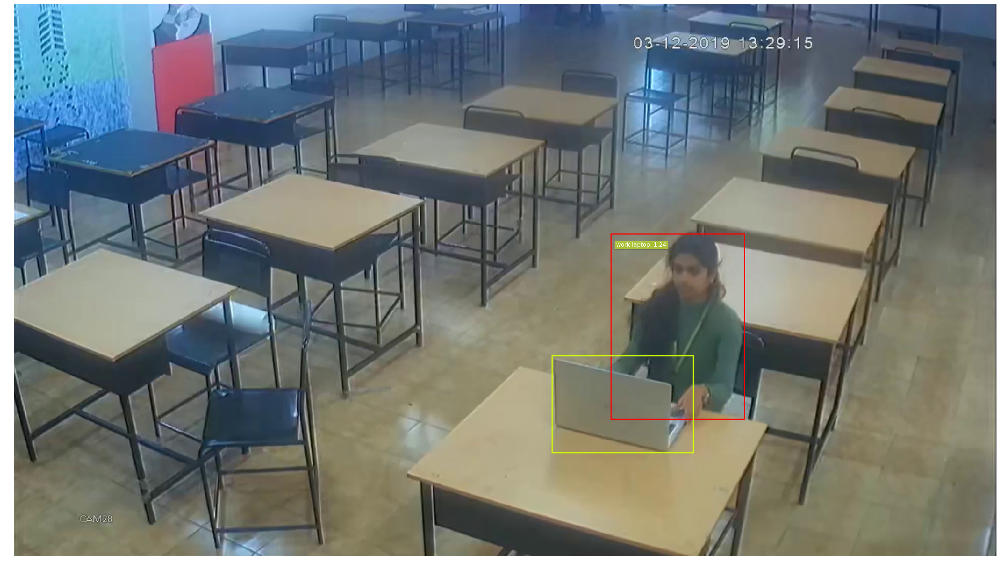

In [19]:
 outputdir=cfg.ROOT_DIR + '/Outputs/'
 for image_id in os.listdir(cfg.ROOT_DIR + '/demo/'):
  print(image_id)
  cc = plt.get_cmap('hsv', lut=6)
  dpi = 50

  im_file = cfg.ROOT_DIR + '/demo/'+image_id
  im_data = plt.imread(im_file)
  height, width, nbands = im_data.shape
  figsize = width / float(dpi), height / float(dpi)
  fig = plt.figure(figsize=figsize)
  ax = fig.add_axes([0, 0, 1, 1])
  ax.axis('off')
  ax.imshow(im_data, interpolation='nearest')

  HO_dic = {}
  HO_set = set()
  count = 0


  for ele in Detection:
      if (ele['image_id'] == image_id):
          action_count = -1
          H_box = ele['person_box'] 
          
          if tuple(H_box) not in HO_set:
              HO_dic[tuple(H_box)] = count
              HO_set.add(tuple(H_box))
              count += 1 
          
          show_H_flag = 0
          
          if ele['smile'][4] > 0.01:
              ax.text(H_box[0] + 10, H_box[1] + 25 + action_count * 35,
              'smile, ' + "%.2f" % ele['smile'][4] ,
              bbox=dict(facecolor=cc(HO_dic[tuple(H_box)])[:3], alpha=0.5),
              fontsize=16, color='white')
              action_count += 1 
              show_H_flag = 1

          if ele['stand'][4] > 0.01:
              ax.text(H_box[0] + 10, H_box[1] + 25 + action_count * 35,
              'stand, ' + "%.2f" % ele['stand'][4] ,
              bbox=dict(facecolor=cc(HO_dic[tuple(H_box)])[:3], alpha=0.5),
              fontsize=16, color='white')
              action_count += 1             
              show_H_flag = 1

          if ele['run'][4] > 0.01:
              ax.text(H_box[0] + 10, H_box[1] + 25 + action_count * 35,
              'run, ' + "%.2f" % ele['run'][4] ,
              bbox=dict(facecolor=cc(HO_dic[tuple(H_box)])[:3], alpha=0.5),
              fontsize=16, color='white')
              action_count += 1  
              show_H_flag = 1

          if ele['walk'][4] > 0.01:
              ax.text(H_box[0] + 10, H_box[1] + 25 + action_count * 35,
              'walk, ' + "%.2f" % ele['walk'][4] ,
              bbox=dict(facecolor=cc(HO_dic[tuple(H_box)])[:3], alpha=0.5),
              fontsize=16, color='white')
              action_count += 1  
              show_H_flag = 1
          
          for action_key, action_value in ele.iteritems():
              if (action_key.split('_')[-1] != 'agent') and action_key != 'image_id' and action_key != 'person_box':
                  if (not np.isnan(action_value[0])) and (action_value[5] > 0.05):
                      O_box = action_value[:4]
                      
                      action_count += 1
                      
                      if tuple(O_box) not in HO_set:
                          HO_dic[tuple(O_box)] = count
                          HO_set.add(tuple(O_box))
                          count += 1      
                  
                      ax.add_patch(
                      plt.Rectangle((H_box[0], H_box[1]),
                                    H_box[2] - H_box[0],
                                    H_box[3] - H_box[1], fill=False,
                                    edgecolor=cc(HO_dic[tuple(H_box)])[:3], linewidth=3)
                      )
                      text = action_key.split('_')[0] + ' ' + CLASSES[np.int(action_value[4])] + ', ' + "%.2f" % action_value[5]

                      ax.text(H_box[0] + 10, H_box[1] + 25 + action_count * 35,
                          text,
                          bbox=dict(facecolor=cc(HO_dic[tuple(O_box)])[:3], alpha=0.5),
                          fontsize=16, color='white')

                      ax.add_patch(
                      plt.Rectangle((O_box[0], O_box[1]),
                                    O_box[2] - O_box[0],
                                    O_box[3] - O_box[1], fill=False,
                                    edgecolor=cc(HO_dic[tuple(O_box)])[:3], linewidth=3)
                      )
                      ax.set(xlim=[0, width], ylim=[height, 0], aspect=1)
          if show_H_flag == 1:
              ax.add_patch(
              plt.Rectangle((H_box[0], H_box[1]),
                            H_box[2] - H_box[0],
                            H_box[3] - H_box[1], fill=False,
                            edgecolor=cc(HO_dic[tuple(H_box)])[:3], linewidth=3)
              )
  plt.savefig(outputdir+image_id)              
          

In [0]:
import cv2
import numpy as np
import glob

In [0]:
def createvideo():
  img_array = []
  img1 = cv2.imread(outputdir+"0.png")
  height1, width1, layers1 = img1.shape
  size = (width1,height1)
  for filename in glob.glob(outputdir+'*.png'):
      img = cv2.imread(filename)
      img_array.append(img)
  
  
  out = cv2.VideoWriter(outputdir+'worklaptop.avi',cv2.VideoWriter_fourcc(*'DIVX'), 2, size)
  
  for i in range(len(img_array)):
      out.write(img_array[i])
  out.release()
  print("Done")

In [26]:
createvideo()

Done
